In [1]:
import pandas as pd
from fbprophet import Prophet
from fbprophet.plot import plot_plotly
import plotly.offline as py
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from fbprophet.plot import plot_cross_validation_metric


In [2]:
df_by_hour = pd.read_csv("total_calls_per_hour.csv")

In [3]:
df_by_hour["ds"] = pd.date_range(min(df_by_hour["ds"]), max(df_by_hour["ds"]), freq='H')

In [4]:
df_by_hour.head()

,Dispatch Date_Dispatch Time,call volume,ds,y
0,2015-01-01 00:00:00,286,2015-01-01 00:00:00,286
1,2015-01-01 01:00:00,265,2015-01-01 01:00:00,265
2,2015-01-01 02:00:00,179,2015-01-01 02:00:00,179
3,2015-01-01 03:00:00,152,2015-01-01 03:00:00,152
4,2015-01-01 04:00:00,127,2015-01-01 04:00:00,127


In [5]:
df_by_hour.tail()


,Dispatch Date_Dispatch Time,call volume,ds,y
43819,2019-12-31 19:00:00,310,2019-12-31 19:00:00,310
43820,2019-12-31 20:00:00,320,2019-12-31 20:00:00,320
43821,2019-12-31 21:00:00,373,2019-12-31 21:00:00,373
43822,2019-12-31 22:00:00,354,2019-12-31 22:00:00,354
43823,2019-12-31 23:00:00,281,2019-12-31 23:00:00,281


In [6]:
m = Prophet()
m.fit(df_by_hour)

In [7]:
future = m.make_future_dataframe(periods=365)
forecast = m.predict(future)

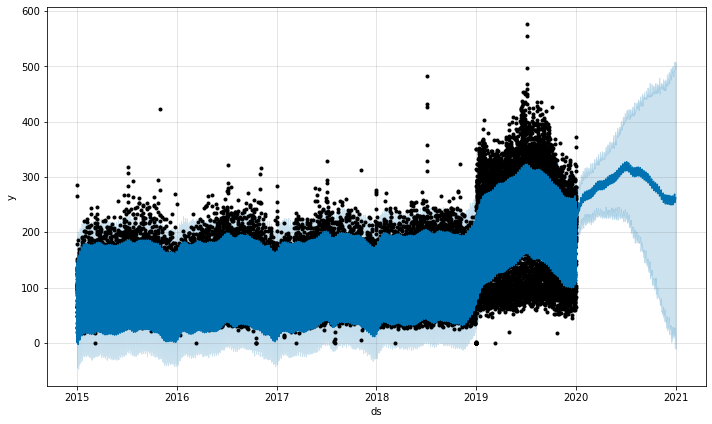

In [8]:
fig1 = m.plot(forecast)

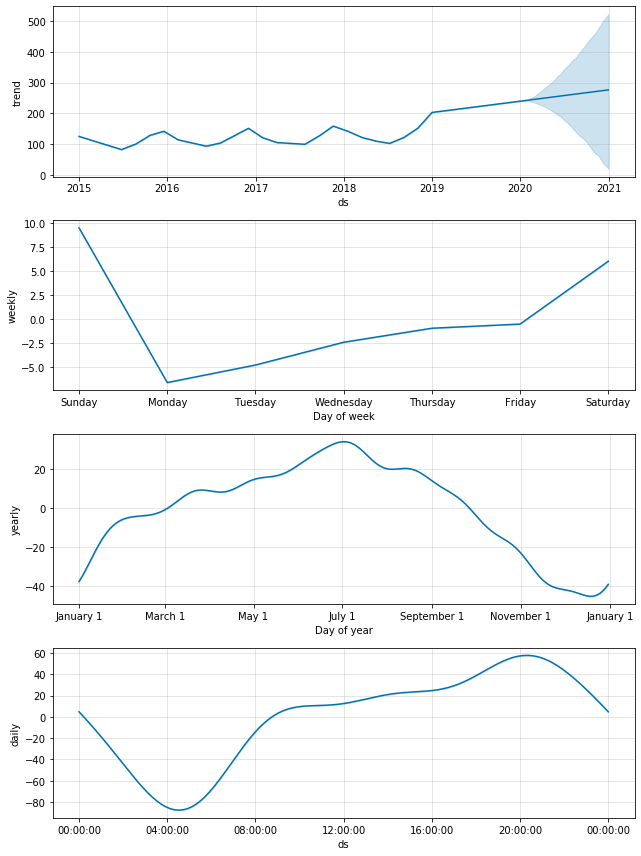

In [9]:
fig2 = m.plot_components(forecast)

In [10]:
py.init_notebook_mode()

fig = plot_plotly(m, forecast)  # This returns a plotly Figure
py.iplot(fig)

In [11]:
df_cv = cross_validation(m, initial='730 days', period='180 days', horizon = '365 days')
df_cv.head()

INFO:fbprophet:Making 5 forecasts with cutoffs between 2017-01-10 23:00:00 and 2018-12-31 23:00:00


,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,2017-01-11 00:00:00,116.720417,89.755111,143.388926,79,2017-01-10 23:00:00
1,2017-01-11 01:00:00,95.601209,70.029270,119.932619,71,2017-01-10 23:00:00
2,2017-01-11 02:00:00,72.024654,44.645713,99.932918,55,2017-01-10 23:00:00
3,2017-01-11 03:00:00,49.361177,20.616884,75.717528,51,2017-01-10 23:00:00
4,2017-01-11 04:00:00,33.166466,7.918128,61.736400,41,2017-01-10 23:00:00


In [12]:
df_p = performance_metrics(df_cv)
df_p.head()

INFO:fbprophet:Skipping MAPE because y close to 0


,horizon,mse,rmse,mae,mdape,coverage
0,36 days 12:00:00,2940.767935,54.228848,33.315765,0.168426,0.657306
1,36 days 13:00:00,2932.212733,54.149910,33.264077,0.167881,0.657991
2,36 days 14:00:00,2922.202179,54.057397,33.216223,0.167469,0.658219
3,36 days 15:00:00,2911.327889,53.956722,33.183357,0.167241,0.658447
4,36 days 16:00:00,2913.200771,53.974075,33.195834,0.167241,0.658219


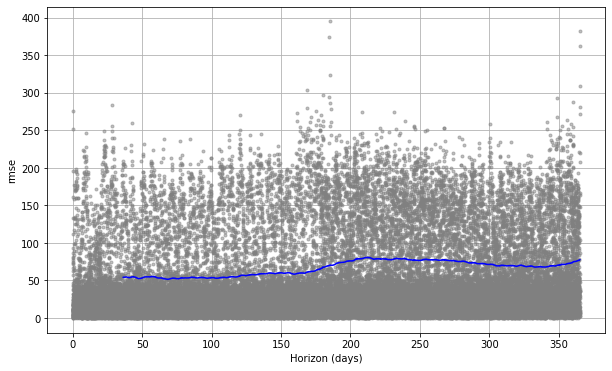

In [18]:
fig = plot_cross_validation_metric(df_cv, metric='rmse')
